# Advanced Lane Finding Project (Finding Lane line / Warp image Part3)

The goals / steps of this project are the following:

* Compute the camera calibration matrix and distortion coefficients given a set of chessboard images.
* Apply a distortion correction to raw images.
* Use color transforms, gradients, etc., to create a thresholded binary image.
* Apply a perspective transform to rectify binary image ("birds-eye view").
* Detect lane pixels and fit to find the lane boundary.
* Determine the curvature of the lane and vehicle position with respect to center.
* Warp the detected lane boundaries back onto the original image.
* Output visual display of the lane boundaries and numerical estimation of lane curvature and vehicle position.

---
## Challenge Video Pipeline ##

In [1]:
import cv2
import glob
import pickle
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from sklearn.metrics import mean_squared_error

import pickle
import sys

import os
import pandas as pd
import matplotlib.gridspec as gridspec

import seaborn as sns

from PIL import Image
from skimage.transform import rescale, resize, rotate
from skimage.color import gray2rgb, rgb2gray
from skimage import transform, filters, exposure
from skimage.io import imread, imsave

from scipy.ndimage.interpolation import rotate

from utils import hls_threshold
from utils import applyCombinedGradient

from utils import *

import platform

%matplotlib inline


***
##   pipelineBinaryImage definition 
***
* normal image to sobelx   
* S channel of HLS binary filtering. 
* then make binary including those 2 categorical mask 

***
##   pipelineBinaryImage2 definition 
***
* l channel of HLS applied to sobelx  
* S channel of HLS binary filtering. 
* then make binary including those 2 categorical mask

### common function to set threshhold values ###

## load saved pickle camera calibration parameters ##

In [2]:
# Read in the saved camera matrix and distortion coefficients
# These are the arrays you calculated using cv2.calibrateCamera()
dist_pickle = pickle.load( open( "./pickled_data/calibration.p", "rb" ) )
mtx = dist_pickle["mtx"]
dist = dist_pickle["dist"]


# Load Challenge Test images and undistortion images from saved directory #

In [3]:
#
# load test images from test_images directory
#
# read with skimage.io.imread (RGB mode)

filenames = sorted( os.listdir("./hard_challenge") )
filenames = [f for f in filenames if "jpg" in f ]

images = {}
imread_ops = lambda x: imread( os.path.join("./hard_challenge",x) )
undist_ops = lambda img:cv2.undistort(img, mtx, dist, None, mtx)
gray_ops = lambda im:cv2.cvtColor(im, cv2.COLOR_RGB2GRAY)

                              
#for f in sorted(filenames):
#    images[f] = imread_ops(f)

                              
#images = list( map( lambda x: imread( os.path.join("./challenge",x)), filenames) )
#undistort_filenames = sorted( os.listdir("./undistort/") )
#undistort_images = list( map( lambda x: imread( os.path.join("./undistort",x)), filenames) )

#undist_images = list( map( undist_ops, images ) )

#undist_gray_images = list( map( gray_ops, undist_images ) )

target_filenames = []
for r in range(125,150):
    f = 'frame{:d}.jpg'.format(r) 
    images[f] = imread_ops(f)

filenames = sorted( images.keys() )

In [4]:
len(images)

25

# definition for rcParams to set image setting

In [5]:
plt.rcParams["figure.figsize"] = (10,6)

# Heler Function 

In [6]:
kernel_size = 5

def draw_pw_lines(img,pts,color):
    # draw lines
    pts = np.int_(pts)
    for i in range(10):
        x1 = pts[0][i][0]
        y1 = pts[0][i][1]
        x2 = pts[0][i+1][0]
        y2 = pts[0][i+1][1]
        cv2.line(img, (x1, y1), (x2, y2),color,50)
        

def undistort_image(img, mtx, dist):
    # Undistort image
    undist_img = cv2.undistort(img, mtx, dist, None, mtx)
    return undist_img
def gaussian_blur(img, kernel=5):
    # Apply Gaussian Blur
    blur = cv2.GaussianBlur(img,(kernel,kernel),0)
    return blur

def abs_sobel_thresh(img, orient='x', sobel_kernel=3, thresh=(0, 255)):
    # Calculate directional gradient
    # Apply threshold
    if orient=='x':
        img_s = cv2.Sobel(img,cv2.CV_64F, 1, 0)
    else:
        img_s = cv2.Sobel(img,cv2.CV_64F, 0, 1)
    img_abs = np.absolute(img_s)
    img_sobel = np.uint8(255*img_abs/np.max(img_abs))
    
    binary_output = 0*img_sobel
    binary_output[(img_sobel >= thresh[0]) & (img_sobel <= thresh[1])] = 1
    return binary_output

def mag_thresh(img, sobel_kernel=3, thresh=(0, 255)):
    # Calculate gradient magnitude
    # Apply threshold
    img_sx = cv2.Sobel(img,cv2.CV_64F, 1, 0)
    img_sy = cv2.Sobel(img,cv2.CV_64F, 0, 1)
    
    img_s = np.sqrt(img_sx**2 + img_sy**2)
    img_s = np.uint8(img_s*255/np.max(img_s))
    binary_output = 0*img_s
    binary_output[(img_s>=thresh[0]) & (img_s<=thresh[1]) ]=1
    return binary_output

def dir_threshold(img, sobel_kernel=3, thresh=(0, np.pi/2)):
    # Calculate gradient direction
    # Apply threshold
    img_sx = cv2.Sobel(img,cv2.CV_64F,1,0, ksize=sobel_kernel)
    img_sy = cv2.Sobel(img,cv2.CV_64F,0,1, ksize=sobel_kernel)
    
    grad_s = np.arctan2(np.absolute(img_sy), np.absolute(img_sx))
    
    binary_output = 0*grad_s # Remove this line
    binary_output[(grad_s>=thresh[0]) & (grad_s<=thresh[1])] = 1
    return binary_output
    
def GaussianC_Adaptive_Threshold(img,kernel,cut_val):
    # Apply Gaussian adaptive thresholding
    img_cut = cv2.adaptiveThreshold(img,255,cv2.ADAPTIVE_THRESH_GAUSSIAN_C,\
            cv2.THRESH_BINARY,kernel,cut_val)
    return img_cut

def warp_image(img,src,dst,img_size):
    # Apply perspective transform
    M = cv2.getPerspectiveTransform(src, dst)
    warped = cv2.warpPerspective(img, M, img_size, flags=cv2.INTER_LINEAR)
    Minv = cv2.getPerspectiveTransform(dst, src)

    return warped,M,Minv

def sobel_combined(image):
    # Apply combined sobel filter
    img_g_mag = mag_thresh(image,3,(20,150))
    img_d_mag = dir_threshold(image,3,(.6,1.1))
    img_abs_x = abs_sobel_thresh(image,'x',5,(50,200))
    img_abs_y = abs_sobel_thresh(image,'y',5,(50,200))
    sobel_combined = np.zeros_like(img_d_mag)
    sobel_combined[((img_abs_x == 1) & (img_abs_y == 1)) | \
               ((img_g_mag == 1) & (img_d_mag == 1))] = 1
    return sobel_combined


def color_mask(hsv,low,high):
    # Return mask from HSV 
    mask = cv2.inRange(hsv, low, high)
    return mask

def apply_color_mask(hsv,img,low,high):
    # Apply color mask to image
    mask = cv2.inRange(hsv, low, high)
    res = cv2.bitwise_and(img,img, mask= mask)
    return res

def moving_average(a, n=3):
    # Moving average
    ret = np.cumsum(a, dtype=float)
    ret[n:] = ret[n:] - ret[:-n]
    return ret[n - 1:] / n



In [7]:
image = list(images.values())[10]
image = images["frame125.jpg"]
#image = images["frame110.jpg"]

print(image.shape)
img_size = np.shape(image)

ht_window = np.uint(img_size[0]/1.5)
hb_window = np.uint(img_size[0])
c_window = np.uint(img_size[1]/2)
ctl_window = c_window - .2*np.uint(img_size[1]/2)
ctr_window = c_window + .2*np.uint(img_size[1]/2)
cbl_window = c_window - .9*np.uint(img_size[1]/2)
cbr_window = c_window + .9*np.uint(img_size[1]/2)

(720, 1280, 3)



# Show original image 

In [8]:
src = np.float32([[cbl_window,hb_window],[cbr_window,hb_window],[ctr_window,ht_window],[ctl_window,ht_window]])

dst = np.float32([[0,img_size[0]],[img_size[1],img_size[0]],
                  [img_size[1],0],[0,0]])



mytest_images = [im for (k, im) in sorted(images.items(), key=lambda x : x[0]) ]
print("original images",  len(mytest_images) )
#
#  read target test files 
#  1. undist 
#  2. warped
# 

warped_images = []
undist_images = []

for image in mytest_images:
    undist_image = undist_ops(image)
    warped,M_warp,Minv_warp = warp_image(undist_image,src,dst,(img_size[1],img_size[0]))
    warped_images.append(warped)
    undist_images.append(undist_image)

print("warped images",len(warped_images))

original images 25
warped images 25


In [9]:
binary_images_list =  np.asarray(list( zip(mytest_images,warped_images) ))
binary_labels = list(map( lambda x:"Warped Image "+x , sorted(images.keys()) ))
binary_images_label =  np.asarray(list( zip(filenames,binary_labels) ))

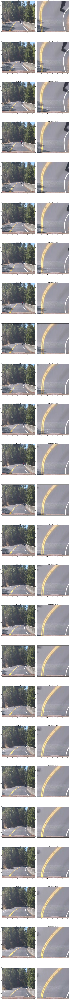

In [10]:

showImageList(binary_images_list, binary_images_label,cols=2,fig_size=(20, 300) )

# Load Single Frame 

In [12]:
src = np.float32([[cbl_window,hb_window],[cbr_window,hb_window],[ctr_window,ht_window],[ctl_window,ht_window]])

dst = np.float32([[0,img_size[0]],[img_size[1],img_size[0]],
                  [img_size[1],0],[0,0]])

undist_image = undist_ops(image)
warped,M_warp,Minv_warp = warp_image(undist_image,src,dst,(img_size[1],img_size[0]))

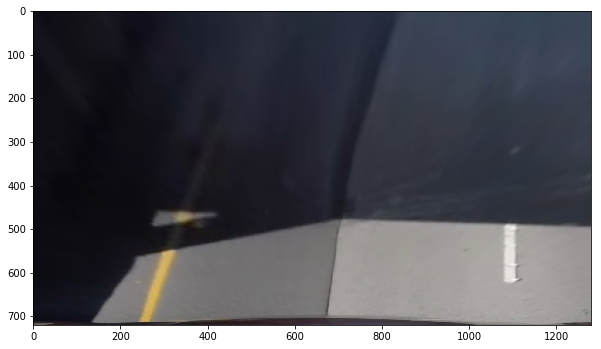

In [13]:
plt.imshow(warped)

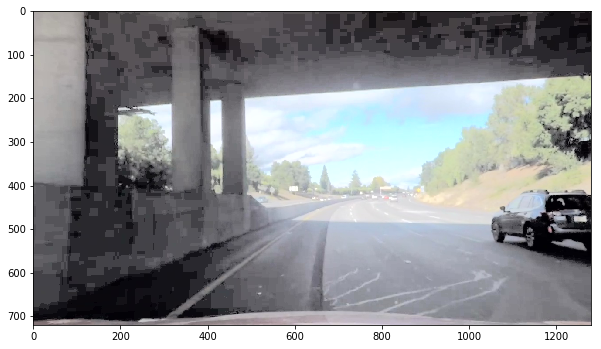

In [15]:
equ_imqge = equYCrCb( undist_image)
#test_binary = applyCombinedGradient(undist_images[10])
plt.imshow(equ_imqge)

In [93]:
warped,M_warp,Minv_warp = warp_image(equ_imqge,src,dst,(img_size[1],img_size[0]))

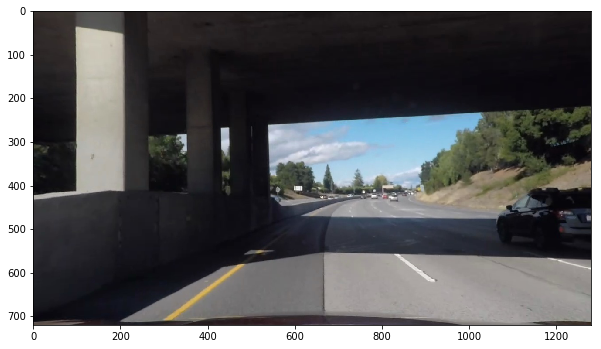

In [14]:
plt.imshow(undist_image)

In [15]:
sns.distplot(equ_imqge.ravel())

NameError: name 'equ_imqge' is not defined

In [11]:
def threshColoredEqImageBin(im):

    image = im.copy()
    # yellow mask
    image_HSV = cv2.cvtColor(image,cv2.COLOR_RGB2HSV)
    yellow_hsv_low  = np.array([ 0, 500,  50])
    yellow_hsv_high = np.array([ 80, 255, 255])    
    res_yellow = apply_color_mask(image_HSV,warped,yellow_hsv_low,yellow_hsv_high)

    # white color mask
    #image_HSV = cv2.cvtColor(image,cv2.COLOR_RGB2HSV)
    #white_hsv_low  = np.array([ 0,   0,   160])
    #white_hsv_high = np.array([ 255,  80, 255])
    
    white_hsv_low  = np.array([  0,   0,    210])
    white_hsv_high = np.array([ 255,  80, 255])

    res_white = apply_color_mask(image_HSV,warped,white_hsv_low,white_hsv_high)

    mask_yellow = color_mask(image_HSV,yellow_hsv_low,yellow_hsv_high)
    mask_white = color_mask(image_HSV,white_hsv_low,white_hsv_high)
    mask_lane = cv2.bitwise_or(mask_yellow,mask_white)

    return mask_lane # ,res_yellow, res_white

#

In [16]:
def threshColoredImageBin(im):

    image = im.copy()
    # yellow mask
    image_HSV = cv2.cvtColor(image,cv2.COLOR_RGB2HSV)
    yellow_hsv_low  = np.array([ 0,  50,  100])
    yellow_hsv_high = np.array([ 80, 255, 255])    
    res_yellow = apply_color_mask(image_HSV,warped,yellow_hsv_low,yellow_hsv_high)

    # white color mask
    #image_HSV = cv2.cvtColor(image,cv2.COLOR_RGB2HSV)
    #white_hsv_low  = np.array([ 0,   0,   160])
    #white_hsv_high = np.array([ 255,  80, 255])
    
    white_hsv_low  = np.array([  0,   0,    200])
    white_hsv_high = np.array([ 255,  80, 255])

    res_white = apply_color_mask(image_HSV,warped,white_hsv_low,white_hsv_high)

    mask_yellow = color_mask(image_HSV,yellow_hsv_low,yellow_hsv_high)
    mask_white = color_mask(image_HSV,white_hsv_low,white_hsv_high)
    mask_lane = cv2.bitwise_or(mask_yellow,mask_white)

    return mask_lane # ,res_yellow, res_white

#
threshColored_ops = lambda x:threshColoredImageBin(x)


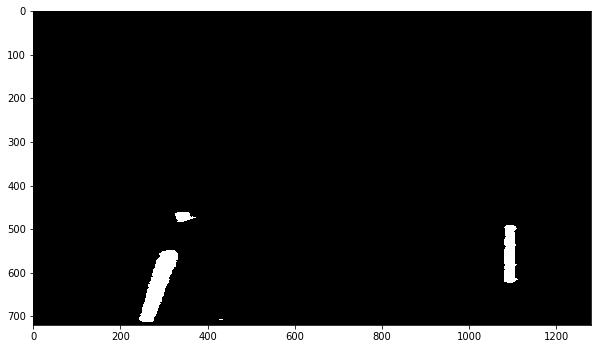

In [17]:

#blur = gaussian_blur(warped, kernel=5)

binLowContrast  = threshColoredImageBin(warped)

#plt.imshow(res_w)
#plt.show()
#plt.imshow(res_y)
#plt.show()
plt.imshow(binLowContrast,cmap="gray")
plt.show()

In [17]:
threshColoredImages = list(map( combinedBinary_ops, warped_images ))

binary_labels = list(map( lambda x:"Warped Image "+x , filenames ))
thres_labels = list(map( lambda x:"threshold Image "+x , filenames ))

warped_images_gray = list( map( gray_ops, warped_images ))

binary_images_list =  np.asarray(list( zip(warped_images_gray, threshColoredImages) ))
binary_images_label =  np.asarray(list( zip(binary_labels, thres_labels ) ))

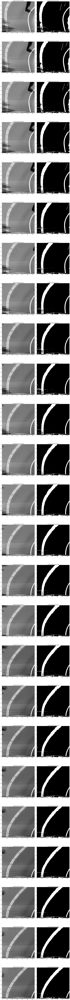

In [18]:
showImageList(binary_images_list, binary_images_label,cols=2,fig_size=(20, 300) )

# Sobel Filter 

In [14]:
def sobelFilter(warped):

    image = gaussian_blur(warped, kernel=5)
    image_HLS = cv2.cvtColor(warped,cv2.COLOR_RGB2HLS)

    img_gs = image_HLS[:,:,1]
    #sobel_c = sobel_combined(img_gs)
    img_abs_x = abs_sobel_thresh(img_gs,'x',15,(50,225))
    img_abs_y = abs_sobel_thresh(img_gs,'y',15,(50,225))
    
    wraped2 = np.copy(cv2.bitwise_or(img_abs_x,img_abs_y))

    img_gs = image_HLS[:,:,2]
    #sobel_c = sobel_combined(img_gs)
    img_abs_x = abs_sobel_thresh(img_gs,'x',15,(50,255))
    img_abs_y = abs_sobel_thresh(img_gs,'y',15,(50,255))

    wraped3 = np.copy(cv2.bitwise_or(img_abs_x,img_abs_y))

    image_cmb = cv2.bitwise_or(wraped2,wraped3)
    
    return image_cmb

def combinedBinaryImage(image):
    
    mask_lane = threshColored_ops(image)
    image_cmb = sobelFilter(image)
    image_cmb1 = np.zeros_like(image_cmb)
    image_cmb1[(mask_lane>=.5)|(image_cmb>=.5)]=1

    return image_cmb1

combinedBinary_ops = lambda x:combinedBinaryImage(x)

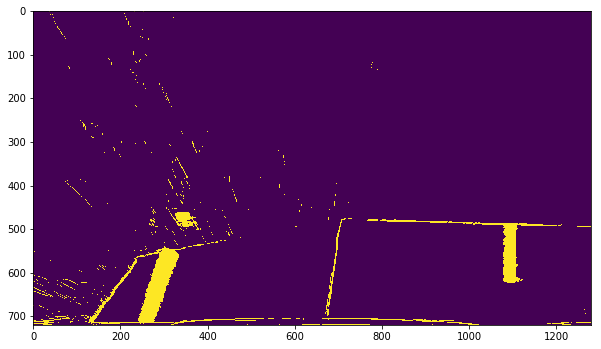

In [26]:

plt.imshow(combinedBinaryImage(warped))

In [47]:
def combined_color_thresholding(
    img, thr_rgb=(230,255), thr_hsv=(230,255), thr_luv=(157,255)):
    """Combines color thresholding on different channels
    
    Returns a binary image.
    
    Args:
        img: Numpy image array, should be in `RGB` color
            space.
        
        thr_rgb: min and max thresholding values for RGB color
            space.
        
        thr_hsv: min and max thresholding values for HSV color
            space.
        
        thr_luv: min and max thresholding values for LUV color
            space.
    """
    
    bin_rgb_ch1, bin_rgb_ch2, bin_rgb_ch3 =\
        color_thresholding(img, ch_type='rgb', thr=thr_rgb)
        
    bin_hsv_ch1, bin_hsv_ch2, bin_hsv_ch3 =\
    color_thresholding(img, ch_type='hsv', thr=thr_hsv)
    
    bin_luv_ch1, bin_luv_ch2, bin_luv_ch3 =\
    color_thresholding(img, ch_type='luv', thr=thr_luv)
    
    binary = np.zeros_like(bin_rgb_ch1)
    binary[
        (bin_rgb_ch1 == 1)
        | (bin_hsv_ch3 == 1)
        | (bin_luv_ch3 == 1)
        ] = 1
    
    return binary

In [48]:
def color_thresholding(
    img, ch_type='rgb', 
    binary=True, plot=False, 
    thr=(220, 255), save_path=None):
    """Apply color thresholding.
    
    Arg:
        img (numpy array): numpy image array, should be in `RGB`
            color space, NOT in `BGR`.
            
        ch_type (str): can be 'rgb', 'hls', 'hsv', 'yuv', 'ycrcb',
            'lab', 'luv'.
            
        binary (bool): If `True` then show and returns binary
            images. If not, returns original images in defined 
            color spaces.
            
        plot: If `True`, shows images.
        
        thr: min, max value for threasholding.
        
        save_path: if defines, saves figures.
    """
    # get channels
    if ch_type is 'hls':
        img = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    elif ch_type is 'hsv':
        img = cv2.cvtColor(img, cv2.COLOR_RGB2HSV)
    elif ch_type is 'yuv':    
        img = cv2.cvtColor(img, cv2.COLOR_RGB2YUV)
    elif ch_type is 'ycrcb':
        img = cv2.cvtColor(img, cv2.COLOR_RGB2YCrCb)
    elif ch_type is 'lab':
        img = cv2.cvtColor(img, cv2.COLOR_RGB2Lab)
    elif ch_type is 'luv':
        img = cv2.cvtColor(img, cv2.COLOR_RGB2Luv)
    
    img_ch1 = img[:,:,0]
    img_ch2 = img[:,:,1]
    img_ch3 = img[:,:,2]

    # apply thresholding
    bin_ch1 = np.zeros_like(img_ch1)
    bin_ch2 = np.zeros_like(img_ch2)
    bin_ch3 = np.zeros_like(img_ch3)

    bin_ch1[(img_ch1 > thr[0]) & (img_ch1 <= thr[1])] = 1
    bin_ch2[(img_ch2 > thr[0]) & (img_ch2 <= thr[1])] = 1
    bin_ch3[(img_ch3 > thr[0]) & (img_ch3 <= thr[1])] = 1
    
    if binary:
        imrep_ch1 = bin_ch1
        imrep_ch2 = bin_ch2
        imrep_ch3 = bin_ch3
    else:
        imrep_ch1 = img_ch1
        imrep_ch2 = img_ch2
        imrep_ch3 = img_ch3
        
    return imrep_ch1, imrep_ch2, imrep_ch3

## Check Binary and Color Image  

## Draw the rectange lines for indentifying the lane lines on the road ##

* for the reference 

In [4]:
#
# Definition of 
# Src and Dst
#
# Hardcoded data points for Perspective window 

src = np.float32([[270,674],
                 [579,460],
                 [702,460],
                 [1060,674]])
dst = np.float32([[270,674],
                 [270,0],
                 [1035,0],
                 [1035,674]])

# for challenge 
src = np.float32([[320,674],
                 [650,460],
                 [702,460],
                 [1060,674]])
dst = np.float32([[270,674],
                 [270,0],
                 [1035,0],
                 [1035,674]])

In [4]:
def M_gen(src,dst):
    
    # Given src and dst points, calculate the perspective transform matrix
    # source is 4 points trapezoid
    # destination is 4 points rectangle
    M = cv2.getPerspectiveTransform(src, dst)
    Minv = cv2.getPerspectiveTransform(dst, src)
    return M, Minv

def warp_gen(img,M):
    # check out the image shape
    img_size = ( img.shape[1], img.shape[0] )
    warped = cv2.warpPerspective(img, M, img_size)
    # Return the resulting image and matrix
    return warped

def undistort_corners(img, mtx, dist):

    # images should be undistortion based on camera calibration.
    # incoming image is RGB format --> skimage.io.imread
    undist = cv2.undistort(img, mtx, dist, None, mtx)
    return undist

In [13]:
def region_of_interest(img, points):
    """Mask the region of interest
    Only keeps the region of the image defined by the polygon
    formed from `points`. The rest of the image is set to black.
    Args:
        img: numpy array representing the image.
        points: verticies, example:
            [[(x1, y1), (x2, y2), (x4, y4), (x3, y3)]]
    """
    # define empty binary mask
    mask = np.zeros_like(img)
    
    # define a mask color to ignore the masking area
    # if there are more than one color channels consider
    # the shape of ignoring mask color
    if len(img.shape) > 2:
        n_chs = img.shape[2]
        ignore_mask_color = (255,) * n_chs
    else:
        ignore_mask_color = 255
    
    # define unmasking region 
    cv2.fillPoly(mask, points, ignore_mask_color)
    
    # mask the image
    masked_img = cv2.bitwise_and(img, mask)
    
    return masked_img

In [42]:
# define a perspective transformation function
def birds_eye_transform(img, points, offsetx):
    """Transforms the viewpoint to a bird's-eye view.
    
    Applies a perspective transformation. Returns
    the inverse matrix and the warped destination
    image.
    
    Args:
        img: A numpy image array.
        points: A list of four points to be flattened.
            Example: points = [[x1,y1], [x2,y2], [x4,y4], [x3,y3]].
        offsetx: offset value for x-axis.
    """
    
    img_size = (img.shape[1], img.shape[0])
    
    
    # get the region of interest
    img = region_of_interest(img, np.array([points]))
    
    src = np.float32(
        [
            points[0],
            points[1],
            points[2],
            points[3],
        ])

    pt1 = [offsetx, 0]
    pt2 = [img_size[0] - offsetx, 0]
    pt3 = [img_size[0] - offsetx, img_size[1]]
    pt4 = [offsetx, img_size[1]]
    dst = np.float32([pt1, pt2, pt3, pt4])
    
    mtx = cv2.getPerspectiveTransform(src, dst)
    invmtx = cv2.getPerspectiveTransform(dst, src)
    
    warped = cv2.warpPerspective(img, mtx, img_size)
    
    return invmtx, warped

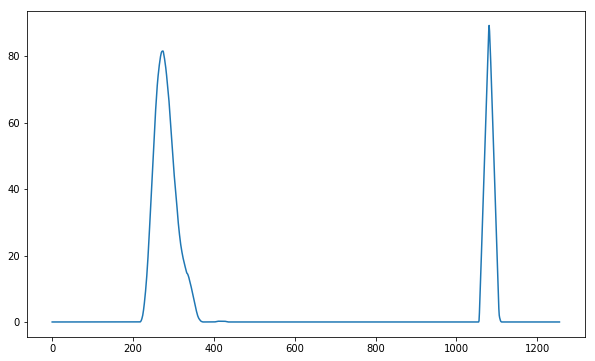

In [27]:
mov_filtsize=binLowContrast.shape[1]//50
mean_lane = np.mean(binLowContrast[  binLowContrast.shape[0]//2:,:  ], axis=0)
mean_lane = moving_average(mean_lane,mov_filtsize)

plt.plot(mean_lane)

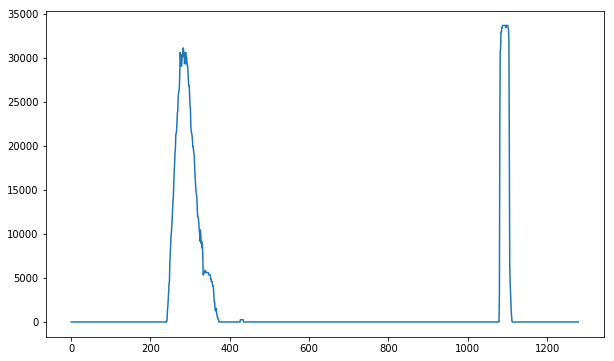

In [28]:
histogram = np.sum(binLowContrast[  binLowContrast.shape[0]//2:,:  ], axis=0)
plt.plot(histogram)

In [38]:
midpoint = np.int(histogram.shape[0]/2)
leftx_base = np.argmax(histogram[:midpoint])
rightx_base = np.argmax(histogram[midpoint:]) + midpoint

nonzero = binLowContrast.nonzero()
nonzeroy = np.array(nonzero[0])
nonzerox = np.array(nonzero[1])


In [39]:
len(nonzeroy),len(nonzerox),leftx_base,rightx_base

(35635, 35635, 346, 1173)

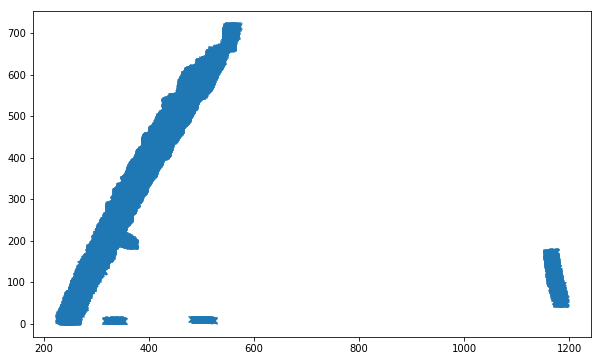

In [40]:
plt.plot(nonzerox,719-nonzeroy,'x')

In [42]:
out_img = np.dstack(( binLowContrast,binLowContrast,binLowContrast )) *255

# Current positions to be updated for each window
leftx_current = leftx_base
rightx_current = rightx_base    

# Set the width of the windows +/- margin
margin = 100 # px
# Set minimum number of pixels found to recenter window
minpix = 30 # 
# Create empty lists to receive left and right lane pixel indices
left_lane_inds = []
right_lane_inds = []
nwindows=9
window_height = np.int(binLowContrast.shape[0]/nwindows)


# for statistical bucketing analysis
leftx_means = []
leftx_stds = []
rightx_means = []
rightx_stds = []

good_left_counts = []
good_right_counts = []
# Step through the windows one by one

for i, window in enumerate(range(nwindows)):
    print("%dth box" % (i+1) )
    # Identify window boundaries in x and y (and right and left)
    win_y_low = binLowContrast.shape[0] - (window+1)*window_height
    win_y_high = binLowContrast.shape[0] - window*window_height
    win_xleft_low = leftx_current - margin
    win_xleft_high = leftx_current + margin
    win_xright_low = rightx_current - margin
    win_xright_high = rightx_current + margin

    # for debug
    #print(i,  win_xleft_low,win_xleft_high,win_xright_low,win_xright_high, win_y_low, win_y_high)
    # Draw the windows on the visualization image
    GREEN_C = (0,255,0)
    cv2.rectangle(out_img,(win_xleft_low,win_y_low),(win_xleft_high,win_y_high),GREEN_C, 4) 
    cv2.rectangle(out_img,(win_xright_low,win_y_low),(win_xright_high,win_y_high),GREEN_C, 4) 

    # Identify the nonzero pixels in x and y within the window
    good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
    (nonzerox >= win_xleft_low) &  (nonzerox < win_xleft_high)).nonzero()[0]
    good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
    (nonzerox >= win_xright_low) &  (nonzerox < win_xright_high)).nonzero()[0]
    # Append these indices to the lists
    left_lane_inds.append(good_left_inds)
    right_lane_inds.append(good_right_inds)
    
    left_lane_inds_upto = np.concatenate(left_lane_inds)
    right_lane_inds_upto = np.concatenate(right_lane_inds)

    
    # If you found > minpix pixels, recenter next window on their mean position
    if len(good_left_inds) > minpix:
        
        good_leftx = nonzerox[good_left_inds]
        good_lefty = nonzeroy[good_left_inds]
        
        leftx_mean = np.mean(good_leftx)
        leftx_std = np.std(good_leftx)
        
        leftx_means.append(leftx_mean)
        leftx_stds.append(leftx_std)
        
        #
        # std calculation if any wide std is given, the last item will be deleted. threshold > 0.5
        #
        leftx_stds_moving_ratio = ( leftx_std - np.mean(leftx_stds[:i+1]) ) / np.mean(leftx_stds[:i+1])
        print("left diffs from piled stds -->",  leftx_stds_moving_ratio )
        if abs(leftx_stds_moving_ratio) > .5:
            del left_lane_inds[-1]
            print("del left_lane_ids")
        else:
            good_left_counts.append(good_leftx)
            
        #print("left diffs from piled means -->", ( leftx_mean - np.mean(leftx_means[:i+1]) ) / np.mean(leftx_means[:i+1])   )
        
        unique, counts = np.unique(good_leftx, return_counts=True)
        dict_good_leftx = dict(zip(unique, counts))
        print("Left most frequent good index:",  sorted(dict_good_leftx,key=dict_good_leftx.get, reverse=True)[:5] )
        
        leftx_current_ = np.int(np.mean(nonzerox[good_left_inds]))

        left_move_ratio = abs(leftx_current - leftx_current_) / leftx_current_         
        #print("left move ratio:",left_move_ratio)
        
        if left_move_ratio < 0.10:
            leftx_current = leftx_current_
        else:
            # drop outlier
            left_lane_inds.remove(good_left_inds)
    else:
        print("** not found good_left_inds on %dth box" % i)
        
    if len(good_right_inds) > minpix:        

        good_rightx = nonzerox[good_right_inds]
        rightx_mean = np.mean(good_rightx)
        rightx_std = np.std(good_rightx)
        
        rightx_means.append(rightx_mean)
        rightx_stds.append(rightx_std)
        
        #
        #  right side std calculation - if any wide std is given, last index will be deleted.
        #
        
        rightx_stds_moving_ratio = ( rightx_std - np.mean(rightx_stds[:i+1]) )  / np.mean(rightx_stds[:i+1])
        #print("right diffs from piled means -->", ( rightx_mean - np.mean(rightx_means[:i+1]) ) / np.mean(rightx_means[:i+1])    )
        print("right diffs from piled stds -->",  rightx_stds_moving_ratio     )
        if abs(rightx_stds_moving_ratio) > 0.5:
            del right_lane_inds[-1]
            print("del right_lane_ids")
        else:
            good_right_counts.append(good_rightx)

        rightx_current_ = np.int(np.mean(nonzerox[good_right_inds]))

        right_move_ratio = abs(rightx_current - rightx_current_) / rightx_current_         
        #print("right move ratio:",right_move_ratio)
        
        if right_move_ratio < 0.10:
            rightx_current = rightx_current_
    else:
        print("** not found good_right_inds on %dth box" % i)
        

    #left_right_lane_diff = np.mean(rightx_means) - np.mean(leftx_means) 
    #print(left_right_lane_diff)
    
    #left_lane_inds_ = np.concatenate(left_lane_inds)
    #right_lane_inds_ = np.concatenate(right_lane_inds)    
            
    #leftx_ = nonzerox[left_lane_inds_]
    #lefty_ = nonzeroy[left_lane_inds_] 
    #rightx_ = nonzerox[right_lane_inds_]
    #righty_ = nonzeroy[right_lane_inds_] 
    #left_fit = np.polyfit(lefty_, leftx_, 2)
    #right_fit = np.polyfit(righty_, rightx_, 2)
    #print("left coefficient", left_fit)
    #print("right coefficient", right_fit)
    
    #print("current position", leftx_current, rightx_current)
        
        
# Concatenate the arrays of indices to make flat array
left_lane_inds = np.concatenate(left_lane_inds)
right_lane_inds = np.concatenate(right_lane_inds)


1th box
left diffs from piled stds --> 0.0
Left most frequent good index: [256, 257, 258, 259, 260]
right diffs from piled stds --> 0.0
2th box
left diffs from piled stds --> -0.1335120036790436
Left most frequent good index: [280, 281, 282, 283, 284]
right diffs from piled stds --> 0.055693419072625074
3th box
left diffs from piled stds --> 0.08201653488166466
Left most frequent good index: [310, 311, 312, 313, 314]
right diffs from piled stds --> -0.10905247010974983
4th box
left diffs from piled stds --> -0.08845010216338985
Left most frequent good index: [336, 337, 338, 339, 340]
** not found good_right_inds on 3th box
5th box
left diffs from piled stds --> -0.018627288103775803
Left most frequent good index: [377, 378, 379, 380, 381]
** not found good_right_inds on 4th box
6th box
left diffs from piled stds --> 0.03514257538583769
Left most frequent good index: [413, 414, 415, 416, 417]
** not found good_right_inds on 5th box
7th box
left diffs from piled stds --> 0.06082351617166

In [24]:
len(good_left_counts)

0

In [25]:
len(good_right_counts)

0

In [26]:
for i in range(len(leftx_means)):
    piled_means = np.mean( leftx_means[:i+1] )
    print(piled_means)
    
#leftx_means - np.mean(leftx_means)   ,leftx_stds - np.mean(leftx_stds)

In [27]:
leftx_means

[]

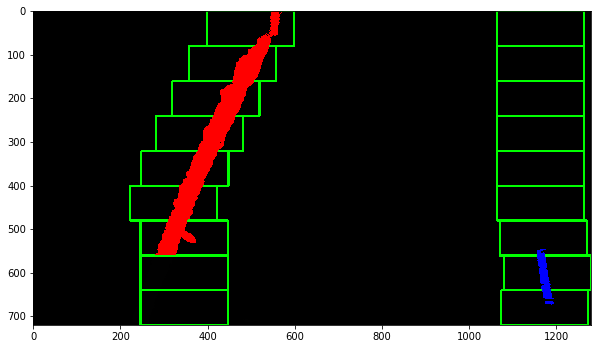

In [43]:
leftx = nonzerox[left_lane_inds]
lefty = nonzeroy[left_lane_inds] 
rightx = nonzerox[right_lane_inds]
righty = nonzeroy[right_lane_inds] 

out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]
plt.imshow(out_img)

In [44]:
left_fit = np.polyfit(lefty, leftx, 2)
right_fit = np.polyfit(righty, rightx, 2)


In [45]:
abs(left_fit[1] - right_fit[1])

0.17546451533936924

(720, 0)

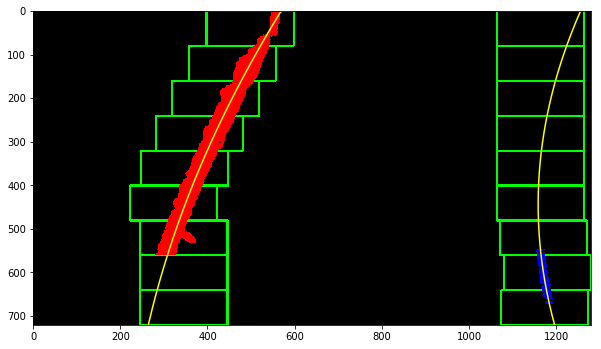

In [46]:
ploty = np.linspace(0, binLowContrast.shape[0]-1, binLowContrast.shape[0] )
left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    
plt.imshow(out_img)
plt.plot(left_fitx, ploty, color='yellow')
plt.plot(right_fitx, ploty, color='yellow')
plt.xlim(0, 1280)
plt.ylim(720, 0)


In [47]:
left_fit,right_fit

(array([ 2.65455911e-04, -6.14231305e-01,  5.69071277e+02]),
 array([ 4.94265406e-04, -4.38766790e-01,  1.25596101e+03]))

In [48]:
# Create an image to draw the lines on
warp_zero = np.zeros_like(binLowContrast).astype(np.uint8)
color_warp = np.dstack((warp_zero, warp_zero, warp_zero))

# Recast the x and y points into usable format for cv2.fillPoly()
pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
pts = np.hstack((pts_left, pts_right))

# Draw the lane onto the warped blank image
cv2.fillPoly(color_warp, np.int_([pts]), (0,255, 0))

img_size = binLowContrast.shape[::-1]
# Warp the blank back to original image space using inverse perspective matrix (Minv)
newwarp = cv2.warpPerspective(color_warp, Minv_warp, img_size ) 
# Combine the result with the original image
result = cv2.addWeighted(undist_image, 1, newwarp, 0.3, 0)

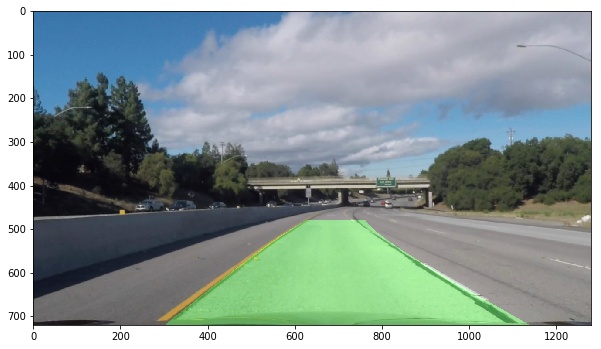

In [49]:
plt.imshow(result)

In [94]:
window_width = 50 
window_height = 80 # Break image into 9 vertical layers since image height is 720
margin = 100 # How much to slide left and right for searching


In [95]:
def window_mask(width, height, img_ref, center,level):
    output = np.zeros_like(img_ref)
    output[int(img_ref.shape[0]-(level+1)*height):int(img_ref.shape[0]-level*height),max(0,int(center-width/2)):min(int(center+width/2),img_ref.shape[1])] = 1
    return output

def find_window_centroids(image, window_width, window_height, margin):
    
    window_centroids = [] # Store the (left,right) window centroid positions per level
    window = np.ones(window_width) # Create our window template that we will use for convolutions
    
    # First find the two starting positions for the left and right lane by using np.sum to get the vertical image slice
    # and then np.convolve the vertical image slice with the window template 
    
    # Sum quarter bottom of image to get slice, could use a different ratio
    l_sum = np.sum(image[int(3*image.shape[0]/4):,:int(image.shape[1]/2)], axis=0)
    l_center = np.argmax(np.convolve(window,l_sum))-window_width/2
    r_sum = np.sum(image[int(3*image.shape[0]/4):,int(image.shape[1]/2):], axis=0)
    r_center = np.argmax(np.convolve(window,r_sum))-window_width/2+int(image.shape[1]/2)
    
    # Add what we found for the first layer
    window_centroids.append((l_center,r_center))
    
    # Go through each layer looking for max pixel locations
    for level in range(1,(int)(image.shape[0]/window_height)):
        # convolve the window into the vertical slice of the image
        image_layer = np.sum(image[int(image.shape[0]-(level+1)*window_height):int(image.shape[0]-level*window_height),:], axis=0)
        conv_signal = np.convolve(window, image_layer)
        # Find the best left centroid by using past left center as a reference
        # Use window_width/2 as offset because convolution signal reference is at right side of window, not center of window
        offset = window_width/2
        l_min_index = int(max(l_center+offset-margin,0))
        l_max_index = int(min(l_center+offset+margin,image.shape[1]))
        l_center = np.argmax(conv_signal[l_min_index:l_max_index])+l_min_index-offset
        # Find the best right centroid by using past right center as a reference
        r_min_index = int(max(r_center+offset-margin,0))
        r_max_index = int(min(r_center+offset+margin,image.shape[1]))
        r_center = np.argmax(conv_signal[r_min_index:r_max_index])+r_min_index-offset
        # Add what we found for that layer
        window_centroids.append((l_center,r_center))

    return window_centroids




In [96]:

window_centroids = find_window_centroids(binLowContrast, window_width, window_height, margin)

In [97]:
window_centroids

[(385.0, 975.0),
 (391.0, 965.0),
 (426.0, 974.0),
 (471.0, 989.0),
 (525.0, 1006.0),
 (552.0, 1041.0),
 (531.0, 1083.0),
 (592.0, 983.0),
 (646.0, 952.0)]

In [98]:
warped = binLowContrast

# If we found any window centers
if len(window_centroids) > 0:

    # Points used to draw all the left and right windows
    l_points = np.zeros_like(warped)
    r_points = np.zeros_like(warped)

    # Go through each level and draw the windows 	
    for level in range(0,len(window_centroids)):
        # Window_mask is a function to draw window areas
        l_mask = window_mask(window_width,window_height,warped,window_centroids[level][0],level)
        r_mask = window_mask(window_width,window_height,warped,window_centroids[level][1],level)
        # Add graphic points from window mask here to total pixels found 
        l_points[(l_points == 255) | ((l_mask == 1) ) ] = 255
        r_points[(r_points == 255) | ((r_mask == 1) ) ] = 255

    # Draw the results
    template = np.array(r_points+l_points,np.uint8) # add both left and right window pixels together
    zero_channel = np.zeros_like(template) # create a zero color channel
    template = np.array(cv2.merge((zero_channel,template,zero_channel)),np.uint8) # make window pixels green
    warpage= np.dstack((warped, warped, warped))*255 # making the original road pixels 3 color channels
    output = cv2.addWeighted(warpage, 1, template, 0.5, 0.0) # overlay the orignal road image with window results

    # If no window centers found, just display orginal road image
else:
    output = np.array(cv2.merge((warped,warped,warped)),np.uint8)

In [99]:
output.shape

(720, 1280, 3)

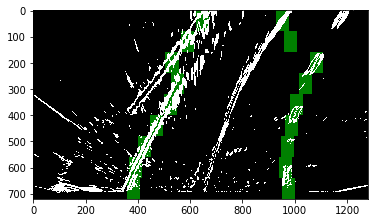

In [100]:
plt.imshow(output)

#### Source is common parameter for all of incoming test images 

In [24]:
def drawTapezoidPolygon(image,src):
    
    copy_image = np.copy(image)
    red = (255,0,0)
    pts = src.astype(np.int32).reshape((-1,1,2))
    polygon_image = cv2.polylines(copy_image ,[pts],True, red, thickness=3)
    return polygon_image


In [39]:
draw_ops = lambda im:drawTapezoidPolygon(im,src)
draw_images = list( map( draw_ops,undist_images ) )
draw_labels = list(map( lambda x:"cropped "+x , filenames ))

#draw_images_list =  np.asarray(list( zip(undist_images,draw_images) ))
#draw_images_label =  np.asarray(list( zip(filenames,draw_labels) ))

In [40]:
def makeWarpViewBinaryImage(image,src,dst,mtx,dist):
    
    M, Minv = M_gen(src,dst)
    undist = undistort_corners(image, mtx, dist)
    warp_image = warp_gen(undist,M)
    _, warp_binary = pipelineBinaryImage4(warp_image)
    
    return warp_binary

In [41]:
def makeBirdViewImages(images,src,dst,mtx,dist):
    #
    # input images --> normal images
    #
    warped_images = []
    for im in images:
        M, Minv = M_gen(src,dst)
        undist = undistort_corners(im, mtx, dist)
        warp_image = warp_gen(undist,M)
        warped_images.append(warp_image)
        
    return warped_images

In [42]:
def variance_of_laplacian(image):
    # compute the Laplacian of the image and then return the focus
    # measure, which is simply the variance of the Laplacian
    gray = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)
    return cv2.Laplacian(gray, cv2.CV_64F).var()

laplacian_ops = lambda im:variance_of_laplacian(im)

def sharpen_image(image):
    kernel = np.array([[-1,-1,-1], [-1,9,-1], [-1,-1,-1]])
    #gray = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)
    image = cv2.filter2D(image, -1, kernel)
    return image

sharpen_image_ops = lambda im:sharpen_image(im)

In [43]:
# input is RGB image
warped_images = makeBirdViewImages(images,src,dst,mtx,dist)

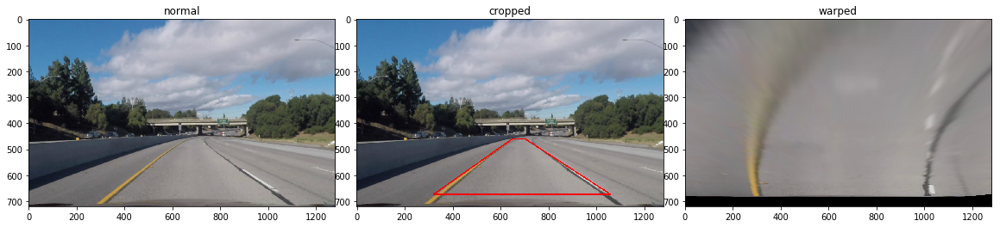

In [48]:
top_image_list = np.array( [ [undist_images[0], draw_images[0], warped_images[0]] ] )
image_labels = np.array( [[ "normal","cropped","warped"] ] )
showImageList(top_image_list, image_labels,cols=3,fig_size=(20, 4) )

## Check Laplacian Filter of Warped Images ##

In [53]:
warp_image_variance_of_laplacian =  list(map(laplacian_ops,warped_images))
sharpen_images =  list(map(sharpen_image_ops,warped_images))

print(warp_image_variance_of_laplacian)

# for reference of normal image
#undist_image_variance_of_laplacian =  list(map(laplacian_ops,undist_images))
#print(undist_image_variance_of_laplacian)

[32.50602964696885, 23.941864144779714, 24.641079623892274, 24.390122604340682, 24.36485350711846, 24.227448991110283, 25.348356114506416, 26.76365124028405, 27.3818142238617, 28.894594170798786, 29.80456269920137, 31.458134731197354, 34.280156235231, 33.672504338393985, 30.318307285897514, 16.89808484392401, 18.271266257645163, 18.747852634588885, 14.624771045966208, 14.106642793438755, 14.665747612704765, 16.53356011281778, 16.371276035219363, 17.734581162134802, 16.78231010902193, 17.930998253485594, 20.067329641920256, 23.07258246497637, 23.22526258668782, 24.064309894910274, 24.84409722116258, 26.835135633669957, 28.18528862202492, 29.45476344655356, 31.49969073853552, 33.18795137615439, 35.55241101476882, 40.429833971394416, 48.440849596884235, 47.18870116804971, 43.158514538799096, 42.08308702237047, 39.7945996069908, 39.53793619744572, 40.57810980732764, 38.74494574403645, 38.29482964403952, 38.252747395362384, 37.149639756148545, 36.8269032108825, 37.007329644067774, 27.696399

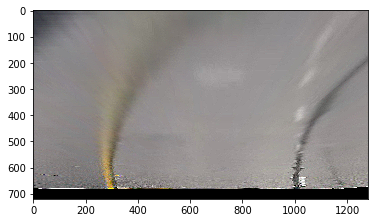

In [55]:
plt.imshow(sharpen_images[0])

***
* After checking out how warped images are blurred with transformation process of warping from original tapezoid crop area, 
most of laplacian values are lower than original.
* If we apply sharpen warped images, it would be easy for extraction program to recognize the displayed lines as lane lines.

In [74]:
def makePipelineColoredBinaryImages(images):

    colored_lane_images = []
    binary_lane_images = []
    for im in images:
        
        # 
        # pipelineBinaryImage4 is used for making binary image
        #
        #binary_ops4 = lambda im:pipelineBinaryImage4(im)
        #c , b = binary_ops4(im)
        binary_ops = lambda im:applyCombinedGradient(im)
        b = binary_ops(im)
        
        colored_lane_images.append(None)
        binary_lane_images.append(b)
    
    return colored_lane_images, binary_lane_images

colored_lane_images, binary_lane_images = makePipelineColoredBinaryImages(warped_images)

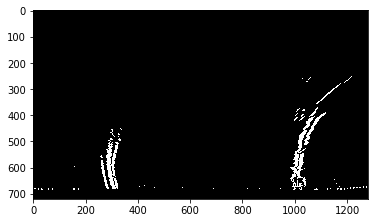

In [76]:
plt.imshow(binary_lane_images[0],cmap="gray")

In [38]:
warped_gray_images = list(map(gray_ops,warped_images))

binary_images_list =  np.asarray(list( zip(warped_gray_images,binary_lane_images) ))
binary_labels = list(map( lambda x:"Gradient Pipeline "+x , filenames ))
binary_images_label =  np.asarray(list( zip(filenames,binary_labels) ))

## Comaparison image Warped Gray Image and Binary / Colored Integrated Image

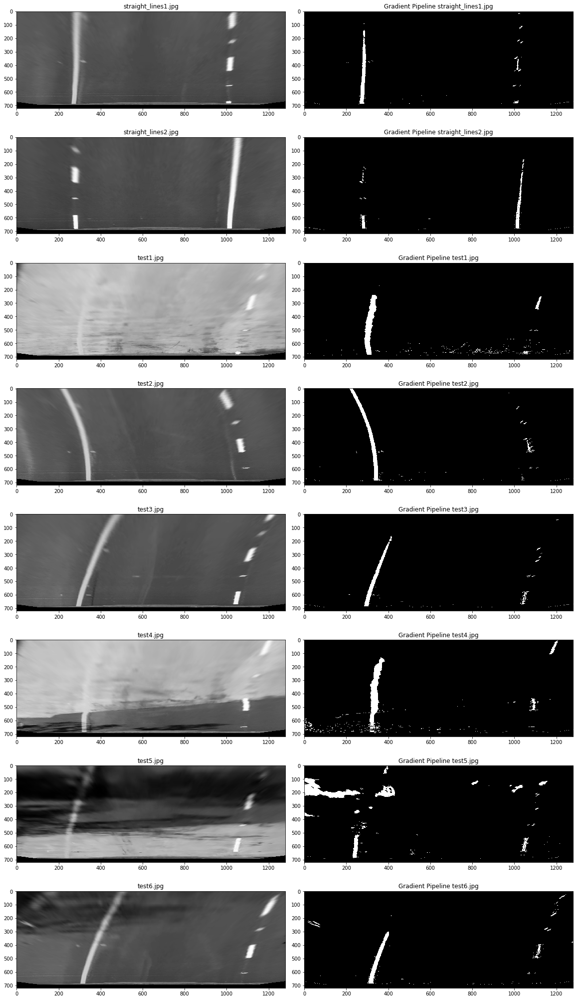

In [39]:
showImageList(binary_images_list, binary_images_label,cols=2,fig_size=(20, 36) )

### Check histogram of binary image axis=0 (x) from half size of image ###

** center -> 640, left -> 280, right -> 997 


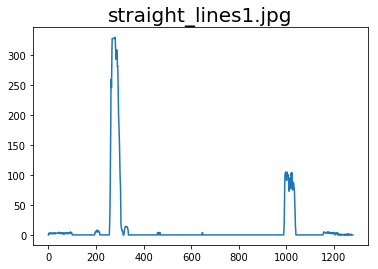

** center -> 640, left -> 286, right -> 1015 


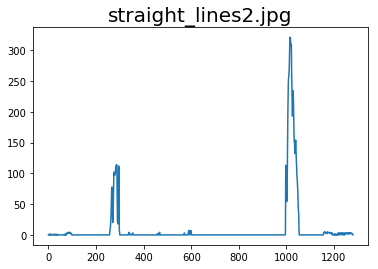

** center -> 640, left -> 309, right -> 890 


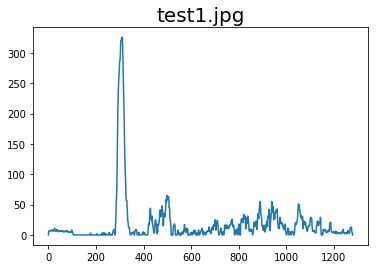

** center -> 640, left -> 333, right -> 1031 


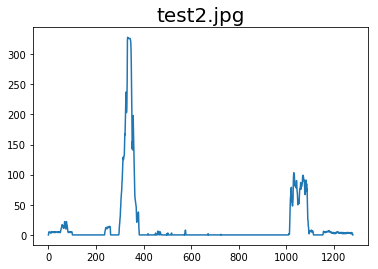

** center -> 640, left -> 334, right -> 1045 


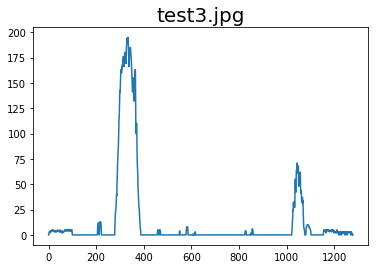

** center -> 640, left -> 336, right -> 1083 


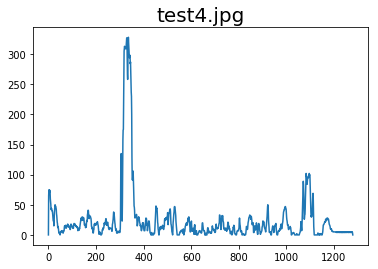

** center -> 640, left -> 249, right -> 1050 


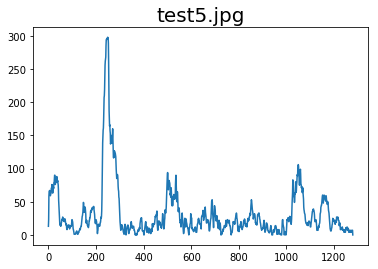

** center -> 640, left -> 360, right -> 1113 


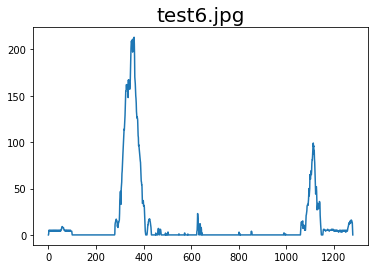

In [21]:
def checkHistograms(filenames,images):
    for f , im in zip(filenames,images):
        histogram = np.sum(im[  im.shape[0]//2:,:  ], axis=0)
        
        midpoint = np.int(histogram.shape[0]/2)
        leftx_base = np.argmax(histogram[:midpoint])
        rightx_base = np.argmax(histogram[midpoint:]) + midpoint
    
        print("** center -> %d, left -> %d, right -> %d " % (midpoint, leftx_base, rightx_base))
        plt.plot(histogram)
        plt.title(f,fontsize=20)
        plt.show()
checkHistograms(filenames,binary_lane_images)

In [22]:
def searchinglaneline(binary_warped):
    # Assuming you have created a warped binary image called "binary_warped"
    # Take a histogram of the bottom half of the image
    histogram = np.sum(binary_warped[binary_warped.shape[0]//2:,:], axis=0)
    #print(histogram)
    # Create an output image to draw on and  visualize the result
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))*255
    # Find the peak of the left and right halves of the histogram
    # These will be the starting point for the left and right lines
    midpoint = np.int(histogram.shape[0]/2)
    leftx_base = np.argmax(histogram[:midpoint])
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint
    
    
    # Choose the number of sliding windows
    nwindows = 9
    #
    # Set height of windows = 720 / 9 = 80px
    # It should be constant if we read video format.
    #
    window_height = np.int(binary_warped.shape[0]/nwindows)
    
    #print("window hight --> %spx " %window_height)
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    
    # Current positions to be updated for each window
    leftx_current = leftx_base
    rightx_current = rightx_base    
    
    # Set the width of the windows +/- margin
    margin = 100 # px
    # Set minimum number of pixels found to recenter window
    minpix = 50 # 
    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []
    
    # Step through the windows one by one
    
    for i, window in enumerate(range(nwindows)):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = binary_warped.shape[0] - (window+1)*window_height
        win_y_high = binary_warped.shape[0] - window*window_height
        win_xleft_low = leftx_current - margin
        win_xleft_high = leftx_current + margin
        win_xright_low = rightx_current - margin
        win_xright_high = rightx_current + margin
        
        # for debug
        #print(i,  win_xleft_low,win_xleft_high,win_xright_low,win_xright_high, win_y_low, win_y_high)
        # Draw the windows on the visualization image
        GREEN_C = (0,255,0)
        cv2.rectangle(out_img,(win_xleft_low,win_y_low),(win_xleft_high,win_y_high),GREEN_C, 4) 
        cv2.rectangle(out_img,(win_xright_low,win_y_low),(win_xright_high,win_y_high),GREEN_C, 4) 
        
        # Identify the nonzero pixels in x and y within the window
        good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
        (nonzerox >= win_xleft_low) &  (nonzerox < win_xleft_high)).nonzero()[0]
        good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
        (nonzerox >= win_xright_low) &  (nonzerox < win_xright_high)).nonzero()[0]
        # Append these indices to the lists
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)
        # If you found > minpix pixels, recenter next window on their mean position
        if len(good_left_inds) > minpix:
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
        if len(good_right_inds) > minpix:        
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))
            
    # Concatenate the arrays of indices to make flat array
    left_lane_inds = np.concatenate(left_lane_inds)
    right_lane_inds = np.concatenate(right_lane_inds)

    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds] 
    
    return out_img,midpoint,leftx_base,rightx_base,leftx,lefty,rightx,righty


def foundlaneline(binary_warped,left_fit,right_fit):
    # Assume you now have a new warped binary image 
    # from the next frame of video (also called "binary_warped")
    # It's now much easier to find line pixels!
    nonzero = binary_warped.nonzero()

    # count nonzero y and nonzero x
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    margin = 100 # px

    left_lane_inds = ((nonzerox > (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + 
    left_fit[2] - margin)) & (nonzerox < (left_fit[0]*(nonzeroy**2) + 
    left_fit[1]*nonzeroy + left_fit[2] + margin))) 

    right_lane_inds = ((nonzerox > (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + 
    right_fit[2] - margin)) & (nonzerox < (right_fit[0]*(nonzeroy**2) + 
    right_fit[1]*nonzeroy + right_fit[2] + margin)))  

    minpix = 50 # 
    
    #print("left lane found px counter:", len(left_lane_inds) )
    #print("right lane found px counter:", len(right_lane_inds) )
    
    # Again, extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]
    # Fit a second order polynomial to each
    return leftx,lefty,rightx,righty

## Radius of Curvature ##


***

* Math Formulation is as follows
* A or B is fitting parameters. 
 $$R_{curve} = \frac{ (1 + (2Ay + B)^2) ^\frac{3}{2}  }{ |2A| } $$



In [32]:
def formula2(a, b, c, y):
    
    x = a * y ** 2 + b * y + c
    return x 

def fitting(lefty,leftx,righty,rightx):

    # Fit a second order polynomial to each
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)

    return left_fit,right_fit

def fitXY(ploty,left_fit,right_fit):
    
    #print("fitXY - left fit:",left_fit)
    #print("fitXY - right fit:",right_fit)    
    
    #left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    #right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    a, b, c = left_fit
    left_fitx = formula2(a, b, c, ploty)
    
    a, b, c = right_fit
    right_fitx = formula2(a, b, c, ploty)
    
    return left_fitx,right_fitx

-
    #print("Curvature result")
    #print(left_curverad, 'm', right_curverad, 'm')

In [24]:
def displyIntegrateView(out_img,ploty,left_fitx,right_fitx):

    plt.figure(figsize=(10,8))
    plt.imshow(out_img)
    plt.plot(left_fitx, ploty, color='yellow')
    plt.plot(right_fitx, ploty, color='yellow')
    #plt.title("Curved Line1",fontsize="22")
    plt.xlim(0, 1280)
    plt.ylim(720, 0)
    plt.show()
    

In [25]:
def genResultImageAfterFitting(binary_warped, ploty, left_fit,right_fit):

    #
    # left_fit & right_fit ==> calculated with fitting method
    #
    
    leftx,lefty,rightx,righty = foundlaneline(binary_warped,left_fit,right_fit)
    left_fit_new,right_fit_new = fitting(lefty,leftx,righty,rightx)
    left_fitx,right_fitx = fitXY(ploty,left_fit_new,right_fit_new)
    
    #
    # This is called after fitting parameters searched with fitting function
    #
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))*255
    window_img = np.zeros_like(out_img)
        
    out_img[lefty,leftx] = [255,0,0] # LEFT RED
    out_img[righty,rightx] = [0,0,255] # RIGHT BLUE
    
    # Color in left and right line pixels
    #out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
    #out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]
    margin = 100
    # Generate a polygon to illustrate the search window area
    # And recast the x and y points into usable format for cv2.fillPoly()
    left_line_window1 = np.array([np.transpose(np.vstack([left_fitx-margin, ploty]))])
    left_line_window2 = np.array([np.flipud(np.transpose(np.vstack([left_fitx+margin, 
                                  ploty])))])
    left_line_pts = np.hstack((left_line_window1, left_line_window2))
    right_line_window1 = np.array([np.transpose(np.vstack([right_fitx-margin, ploty]))])
    right_line_window2 = np.array([np.flipud(np.transpose(np.vstack([right_fitx+margin, 
                                  ploty])))])
    right_line_pts = np.hstack((right_line_window1, right_line_window2))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(window_img, np.int_([left_line_pts]), (0,255, 0))
    cv2.fillPoly(window_img, np.int_([right_line_pts]), (0,255, 0))
    result = cv2.addWeighted(out_img, 1, window_img, 0.3, 0)
    
    #displyIntegrateView(result,ploty,left_fitx,right_fitx)

    return result, left_fitx, right_fitx

In [26]:
def drawPolygonZoneOnLane(image, result, ploty, left_fitx, right_fitx, Minv):
    
    # %% Warp the detected lane boundaries back onto the original image
    # # Recast the x and y points into usable format for cv2.fillPoly()
    pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
    pts = np.hstack((pts_left, pts_right))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(result, np.int_([pts]), (0,255, 0))    
    
    img_size = ( result.shape[1], result.shape[0] )
    newwarp = cv2.warpPerspective(result, Minv, (img_size[0], img_size[1])) 
    newwarp = np.uint8(newwarp)
        
    # Combine the result with the original image
    final = cv2.addWeighted(image, 1, newwarp, 0.5, 0)
    return final
    #plt.figure(figsize=(10,8))
    #plt.imshow(final)
    #plt.show()

In [42]:
def testPipeline(im):

    M, Minv = M_gen(src,dst)
    undist = undistort_corners(im, mtx, dist)
    warp_image = warp_gen(undist,M)
    
    binary_ops = lambda im:pipelineBinaryImage4(im)
    c , b = binary_ops(warp_image)
    
    out_img,midpoint,leftx_base,rightx_base,leftx,lefty,rightx,righty = searchinglaneline(b)
    ploty = np.linspace(0, im.shape[0]-1, im.shape[0] )

    #out_img[lefty,leftx] = [255,0,0] # LEFT RED
    #out_img[righty,rightx] = [0,0,255] # RIGHT BLUE
    #result_marking_images.append(out_img)
    
    # fitting to get a * y^2 + b * y + c
    # get coefficient for formula from searched scattered point (x y)
    left_fit,right_fit = fitting(lefty,leftx,righty,rightx)
    
    # one solid line based on fitted parameters and Y (0-720)
    # line should be displayed on Yellow
    # based coefficient and ploty, curved line is generated
    # left_fitx / right_fitx are x value on generated left and right curved lines.
    left_fitx,right_fitx = fitXY(ploty,left_fit,right_fit)
    
    #displyIntegrateView(out_img,ploty,left_fitx,right_fitx)
    #
    # after finding lane line, following process should be called.
    # 
    # left_fitx / right_fitx are generated result plot value based on fitting (polyfit)
    result, left_fitx, right_fitx = genResultImageAfterFitting(b, ploty, left_fit,right_fit)
    left_curverad, right_curverad = curvature(ploty, left_fitx, right_fitx)

    
    fontScale = 2
    font = cv2.FONT_HERSHEY_SIMPLEX
    fontColor = (255, 255, 255)
    cv2.putText(undist, 'Left Curvature ->  {:.3f} m'.format(left_curverad), (50, 50), font, fontScale, fontColor, 2)
    cv2.putText(undist, 'Right Curvature ->  {:.3f} m '.format(right_curverad), (50, 100), font, fontScale, fontColor, 2)

    return drawPolygonZoneOnLane(undist, result, ploty, left_fitx, right_fitx, Minv)
    

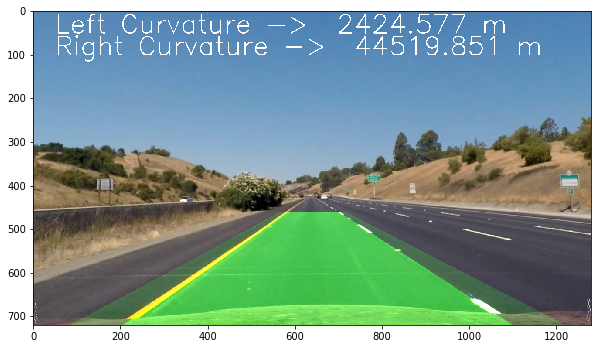

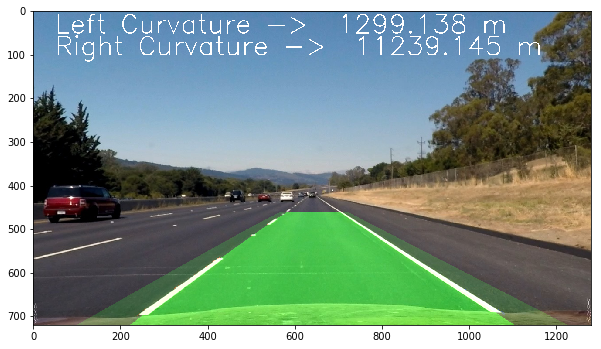

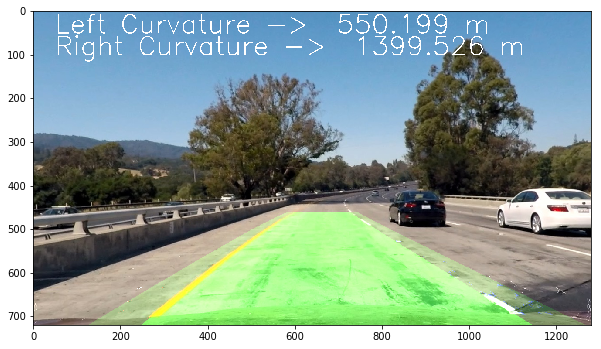

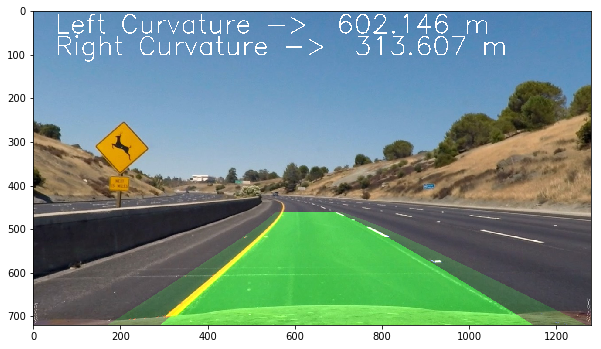

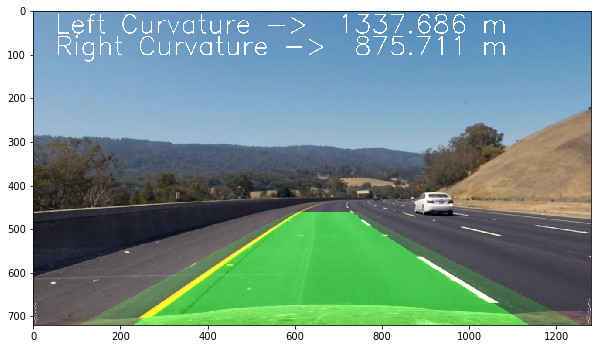

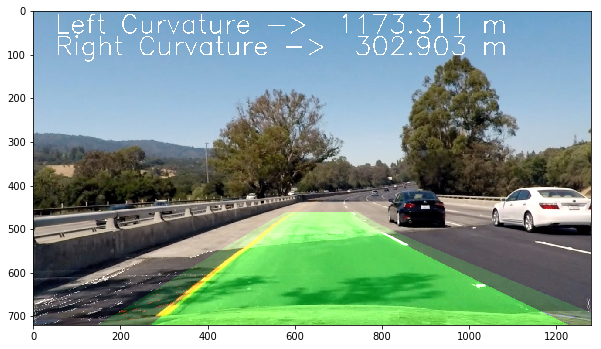

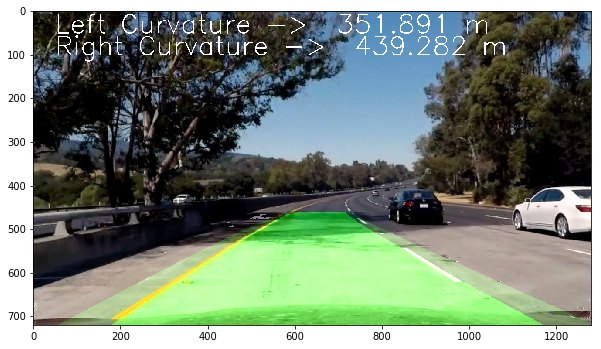

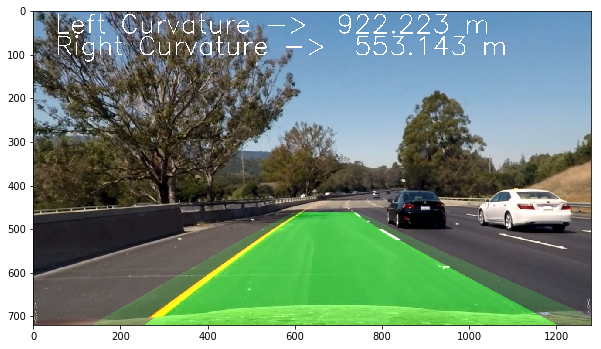

In [43]:
for im in images:
    testim =  testPipeline(im)
    plt.figure(figsize=(10,8))
    plt.imshow(testim)
    plt.show()

# Video Clip 

In [77]:
# Import everything needed to edit/save/watch video clips
from moviepy.editor import VideoFileClip
from IPython.display import HTML
from moviepy.video.io.ffmpeg_tools import ffmpeg_extract_subclip

In [78]:
in_file = "project_video.mp4"
out_file = os.path.join("output_images",in_file)

print('Processing video ...')
clip2 = VideoFileClip(in_file)
vid_clip = clip2.fl_image(testPipeline)
%time vid_clip.write_videofile(out_file, audio=False)

Processing video ...
[MoviePy] >>>> Building video output_images/project_video.mp4
[MoviePy] Writing video output_images/project_video.mp4




  0%|          | 0/1261 [00:00<?, ?it/s]

  0%|          | 1/1261 [00:00<03:53,  5.40it/s]

  0%|          | 2/1261 [00:00<03:50,  5.46it/s]

  0%|          | 3/1261 [00:00<03:40,  5.70it/s]

  0%|          | 4/1261 [00:00<03:41,  5.67it/s]

  0%|          | 5/1261 [00:00<03:43,  5.61it/s]

  0%|          | 6/1261 [00:01<03:42,  5.63it/s]

  1%|          | 7/1261 [00:01<03:50,  5.45it/s]

  1%|          | 8/1261 [00:01<03:50,  5.44it/s]

  1%|          | 9/1261 [00:01<03:37,  5.75it/s]

  1%|          | 10/1261 [00:01<04:02,  5.15it/s]

  1%|          | 11/1261 [00:01<03:48,  5.47it/s]

  1%|          | 12/1261 [00:02<03:43,  5.58it/s]

  1%|          | 13/1261 [00:02<03:40,  5.67it/s]

  1%|          | 14/1261 [00:02<03:48,  5.45it/s]

  1%|          | 15/1261 [00:02<03:47,  5.49it/s]

  1%|▏         | 16/1261 [00:02<03:43,  5.57it/s]

  1%|▏         | 17/1261 [00:03<03:44,  5.55it/s]

  1%|▏         | 18/1261 [00:03<04:00,  5.16it/s]

  2%|▏         | 19/1261 [00:03<03:46,  5.48it/

 23%|██▎       | 284/1261 [01:02<02:51,  5.71it/s]

 23%|██▎       | 285/1261 [01:03<02:57,  5.50it/s]

 23%|██▎       | 286/1261 [01:03<02:53,  5.63it/s]

 23%|██▎       | 287/1261 [01:03<02:51,  5.67it/s]

 23%|██▎       | 288/1261 [01:03<02:50,  5.70it/s]

 23%|██▎       | 289/1261 [01:03<03:00,  5.38it/s]

 23%|██▎       | 290/1261 [01:03<02:57,  5.46it/s]

 23%|██▎       | 291/1261 [01:04<02:51,  5.64it/s]

 23%|██▎       | 292/1261 [01:04<02:52,  5.63it/s]

 23%|██▎       | 293/1261 [01:04<02:55,  5.51it/s]

 23%|██▎       | 294/1261 [01:04<02:48,  5.75it/s]

 23%|██▎       | 295/1261 [01:04<02:46,  5.80it/s]

 23%|██▎       | 296/1261 [01:04<02:47,  5.76it/s]

 24%|██▎       | 297/1261 [01:05<02:49,  5.70it/s]

 24%|██▎       | 298/1261 [01:05<02:50,  5.64it/s]

 24%|██▎       | 299/1261 [01:05<02:46,  5.79it/s]

 24%|██▍       | 300/1261 [01:05<02:43,  5.86it/s]

 24%|██▍       | 301/1261 [01:05<02:43,  5.87it/s]

 24%|██▍       | 302/1261 [01:05<02:44,  5.84it/s]

 24%|██▍    

 45%|████▍     | 566/1261 [01:51<01:54,  6.06it/s]

 45%|████▍     | 567/1261 [01:51<01:54,  6.08it/s]

 45%|████▌     | 568/1261 [01:51<01:54,  6.07it/s]

 45%|████▌     | 569/1261 [01:51<01:52,  6.12it/s]

 45%|████▌     | 570/1261 [01:52<01:53,  6.09it/s]

 45%|████▌     | 571/1261 [01:52<01:52,  6.14it/s]

 45%|████▌     | 572/1261 [01:52<01:53,  6.07it/s]

 45%|████▌     | 573/1261 [01:52<01:54,  6.01it/s]

 46%|████▌     | 574/1261 [01:52<01:53,  6.06it/s]

 46%|████▌     | 575/1261 [01:52<01:52,  6.08it/s]

 46%|████▌     | 576/1261 [01:53<01:52,  6.07it/s]

 46%|████▌     | 577/1261 [01:53<01:50,  6.18it/s]

 46%|████▌     | 578/1261 [01:53<01:49,  6.24it/s]

 46%|████▌     | 579/1261 [01:53<01:47,  6.35it/s]

 46%|████▌     | 580/1261 [01:53<01:48,  6.27it/s]

 46%|████▌     | 581/1261 [01:53<01:47,  6.30it/s]

 46%|████▌     | 582/1261 [01:53<01:47,  6.31it/s]

 46%|████▌     | 583/1261 [01:54<01:47,  6.31it/s]

 46%|████▋     | 584/1261 [01:54<01:49,  6.19it/s]

 46%|████▋  

 67%|██████▋   | 848/1261 [02:38<01:11,  5.77it/s]

 67%|██████▋   | 849/1261 [02:38<01:11,  5.78it/s]

 67%|██████▋   | 850/1261 [02:39<01:10,  5.80it/s]

 67%|██████▋   | 851/1261 [02:39<01:09,  5.92it/s]

 68%|██████▊   | 852/1261 [02:39<01:09,  5.88it/s]

 68%|██████▊   | 853/1261 [02:39<01:13,  5.57it/s]

 68%|██████▊   | 854/1261 [02:39<01:11,  5.69it/s]

 68%|██████▊   | 855/1261 [02:40<01:11,  5.71it/s]

 68%|██████▊   | 856/1261 [02:40<01:10,  5.75it/s]

 68%|██████▊   | 857/1261 [02:40<01:08,  5.87it/s]

 68%|██████▊   | 858/1261 [02:40<01:08,  5.85it/s]

 68%|██████▊   | 859/1261 [02:40<01:08,  5.87it/s]

 68%|██████▊   | 860/1261 [02:40<01:07,  5.97it/s]

 68%|██████▊   | 861/1261 [02:41<01:06,  5.98it/s]

 68%|██████▊   | 862/1261 [02:41<01:06,  5.99it/s]

 68%|██████▊   | 863/1261 [02:41<01:06,  6.01it/s]

 69%|██████▊   | 864/1261 [02:41<01:06,  5.95it/s]

 69%|██████▊   | 865/1261 [02:41<01:06,  5.99it/s]

 69%|██████▊   | 866/1261 [02:41<01:07,  5.87it/s]

 69%|██████▉

 89%|████████▉ | 1128/1261 [03:30<00:19,  6.98it/s]

 90%|████████▉ | 1129/1261 [03:31<00:18,  6.98it/s]

 90%|████████▉ | 1130/1261 [03:31<00:18,  6.98it/s]

 90%|████████▉ | 1131/1261 [03:31<00:20,  6.36it/s]

 90%|████████▉ | 1132/1261 [03:31<00:19,  6.47it/s]

 90%|████████▉ | 1133/1261 [03:31<00:19,  6.50it/s]

 90%|████████▉ | 1134/1261 [03:31<00:19,  6.56it/s]

 90%|█████████ | 1135/1261 [03:32<00:19,  6.51it/s]

 90%|█████████ | 1136/1261 [03:32<00:18,  6.64it/s]

 90%|█████████ | 1137/1261 [03:32<00:18,  6.75it/s]

 90%|█████████ | 1138/1261 [03:32<00:18,  6.78it/s]

 90%|█████████ | 1139/1261 [03:32<00:18,  6.70it/s]

 90%|█████████ | 1140/1261 [03:32<00:17,  6.77it/s]

 90%|█████████ | 1141/1261 [03:32<00:17,  6.81it/s]

 91%|█████████ | 1142/1261 [03:33<00:17,  6.79it/s]

 91%|█████████ | 1143/1261 [03:33<00:17,  6.74it/s]

 91%|█████████ | 1144/1261 [03:33<00:17,  6.81it/s]

 91%|█████████ | 1145/1261 [03:33<00:17,  6.79it/s]

 91%|█████████ | 1146/1261 [03:33<00:16,  6.83

[MoviePy] Done.
[MoviePy] >>>> Video ready: output_images/project_video.mp4 

CPU times: user 4min, sys: 40.4 s, total: 4min 41s
Wall time: 3min 56s
